### **Requirements**

In [1]:
pip install pycaret ydata_profiling

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.0/61.0 kB 3.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.4/60.4 kB 2.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.3/46.3 kB 3.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
INFO: pip is looking at multiple versions of category-encoders to determine which version is compatible with other requirements. This could take a while.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 486.1/486.1 kB 15.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 106.8/106.8 kB 4.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.8/21.8 MB 49.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 400.1/400.1 kB 20.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 18.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 85.4/85.4 kB 6.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 302.2/302.2 kB 11.1 MB/s eta 0:00:00
   ━

---

# **Perceptron**

In this notebook I will give an example of using a basic neural network - a perceptron, for the task of classifying demand

---

## **Libraries**

In [16]:
import kagglehub
import os
import pandas as pd
import numpy as np
from ydata_profiling import ProfileReport
from pycaret.classification import setup, compare_models, get_config

import torch.nn as nn
import torch.optim as optim
import torch
import torch.utils.data as data

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers

from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt
from sklearn.neural_network import MLPClassifier
from tqdm import tqdm

---

## **Dataset**

**Context**

This dataset contains an airline passenger satisfaction survey. What factors are highly correlated to a satisfied (or dissatisfied) passenger? Can you predict passenger satisfaction?

**Content**

1. Gender: Gender of the passengers (Female, Male)

2. Customer Type: The customer type (Loyal customer, disloyal customer)

3. Age: The actual age of the passengers

4. Type of Travel: Purpose of the flight of the passengers (Personal Travel, Business Travel)

5. Class: Travel class in the plane of the passengers (Business, Eco, Eco Plus)

6. Flight distance: The flight distance of this journey

7. Inflight wifi service: Satisfaction level of the inflight wifi service (0:Not Applicable;1-5)

8. Departure/Arrival time convenient: Satisfaction level of Departure/Arrival time convenient

9. Ease of Online booking: Satisfaction level of online booking

10. Gate location: Satisfaction level of Gate location

11. Food and drink: Satisfaction level of Food and drink

12. Online boarding: Satisfaction level of online boarding

13. Seat comfort: Satisfaction level of Seat comfort

14. Inflight entertainment: Satisfaction level of inflight entertainment

15. On-board service: Satisfaction level of On-board service

16. Leg room service: Satisfaction level of Leg room service

17. Baggage handling: Satisfaction level of baggage handling

18. Check-in service: Satisfaction level of Check-in service

19. Inflight service: Satisfaction level of inflight service

20. Cleanliness: Satisfaction level of Cleanliness

21. Departure Delay in Minutes: Minutes delayed when departure

22. Arrival Delay in Minutes: Minutes delayed when Arrival

23. Satisfaction: Airline satisfaction level(Satisfaction, neutral or dissatisfaction)



In [2]:
path = kagglehub.dataset_download("teejmahal20/airline-passenger-satisfaction")
os.listdir(path)

100%|██████████| 2.71M/2.71M [00:00<00:00, 130MB/s]

Extracting files...


['test.csv', 'train.csv']

In [3]:
data = pd.read_csv(os.path.join(path, os.listdir(path)[1]))
new_data = data.drop(['Unnamed: 0', 'id'], axis=1)

In [4]:
new_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 103904 entries, 0 to 103903
Data columns (total 23 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   Gender                             103904 non-null  object 
 1   Customer Type                      103904 non-null  object 
 2   Age                                103904 non-null  int64  
 3   Type of Travel                     103904 non-null  object 
 4   Class                              103904 non-null  object 
 5   Flight Distance                    103904 non-null  int64  
 6   Inflight wifi service              103904 non-null  int64  
 7   Departure/Arrival time convenient  103904 non-null  int64  
 8   Ease of Online booking             103904 non-null  int64  
 9   Gate location                      103904 non-null  int64  
 10  Food and drink                     103904 non-null  int64  
 11  Online boarding                    1039

---

## **Profiling**

In [5]:
profile = ProfileReport(new_data, title="Profiling Report", explorative=True)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 23/23 [00:02<00:00,  7.73it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

There are missing values in the data, accounting for less than 0.1%.

---

## **Preprocessing**

Remove missing values

In [6]:
new_data.dropna(ignore_index=True, inplace=True)

Preparing data

In [7]:
S = setup(data=new_data, target='satisfaction', verbose=True, normalize=True)

,Description,Value
0,Session id,7779
1,Target,satisfaction
2,Target type,Binary
3,Target mapping,"neutral or dissatisfied: 0, satisfied: 1"
4,Original data shape,"(103594, 23)"
5,Transformed data shape,"(103594, 25)"
6,Transformed train set shape,"(72515, 25)"
7,Transformed test set shape,"(31079, 25)"
8,Numeric features,18
9,Categorical features,4


I split the data into training and testing sets. It would also be beneficial to include a validation set

In [8]:
X_train, X_test, y_train, y_test = get_config('X_train_transformed'), get_config('X_test_transformed'), get_config('y_train_transformed'), get_config('y_test_transformed')
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((72515, 24), (31079, 24), (72515,), (31079,))

In [9]:
X_train, X_test, y_train, y_test = torch.tensor(X_train.values, dtype=torch.float32), torch.tensor(X_test.values, dtype=torch.float32), torch.tensor(y_train.values, dtype=torch.float32), torch.tensor(y_test.values, dtype=torch.float32)
X_train.shape, X_test.shape, y_train.shape, y_test.shape

(torch.Size([72515, 24]),
 torch.Size([31079, 24]),
 torch.Size([72515]),
 torch.Size([31079]))

---

## **Model**

I analyze the performance of classical machine learning models to benchmark and compare them against the Perceptron

In [10]:
best = compare_models(include = ['ridge', 'lr', 'knn', 'nb', 'dt', 'svm', 'rf', 'qda', 'ada', 'gbc', 'lda',
                                 'et', 'xgboost', 'lightgbm', 'dummy'], fold = 10, n_select=20)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
lightgbm,Light Gradient Boosting Machine,0.9636,0.9950,0.9636,0.9639,0.9636,0.9257,0.9261,4.6790
xgboost,Extreme Gradient Boosting,0.9628,0.9950,0.9628,0.9629,0.9627,0.9239,0.9242,1.6280
rf,Random Forest Classifier,0.9604,0.9934,0.9604,0.9607,0.9603,0.9191,0.9195,9.1370
et,Extra Trees Classifier,0.9588,0.9925,0.9588,0.9590,0.9587,0.9157,0.9161,8.9300
dt,Decision Tree Classifier,0.9437,0.9431,0.9437,0.9438,0.9437,0.8854,0.8855,1.2080
gbc,Gradient Boosting Classifier,0.9421,0.9876,0.9421,0.9422,0.9421,0.8818,0.8821,12.5320
ada,Ada Boost Classifier,0.9279,0.9779,0.9279,0.9279,0.9278,0.8529,0.8530,3.5820
knn,K Neighbors Classifier,0.9244,0.9671,0.9244,0.9257,0.9239,0.8446,0.8466,7.0820
svm,SVM - Linear Kernel,0.8757,0.9261,0.8757,0.8761,0.8752,0.7450,0.7464,1.1400
lr,Logistic Regression,0.8752,0.9269,0.8752,0.8751,0.8749,0.7447,0.7452,0.8910


Processing:   0%|          | 0/79 [00:00<?, ?it/s]

Overall, the ensemble models performed the best, particularly bagging and boosting methods

### **Sk-learn**

I use the Perceptron implementation from Scikit-learn.

In [11]:
mlp = MLPClassifier(
    hidden_layer_sizes=(20, 20),
    activation='relu',
    solver='adam',
    alpha=0.0001,
    batch_size='auto',
    learning_rate='adaptive',
    learning_rate_init=0.001,
    max_iter=300,
    shuffle=True,
    random_state=42,
    tol=1e-4,
    verbose=True,
    warm_start=False,
    early_stopping=True,
    validation_fraction=0.1,
    beta_1=0.9,
    beta_2=0.999,
    epsilon=1e-8,
    n_iter_no_change=10
)


In [12]:
mlp.fit(X_train, y_train)

Iteration 1, loss = 0.34826107
Validation score: 0.904026
Iteration 2, loss = 0.21110680
Validation score: 0.925951
Iteration 3, loss = 0.17808556
Validation score: 0.933811
Iteration 4, loss = 0.16237498
Validation score: 0.939327
Iteration 5, loss = 0.15262642
Validation score: 0.941671
Iteration 6, loss = 0.14483274
Validation score: 0.943188
Iteration 7, loss = 0.13861516
Validation score: 0.947049
Iteration 8, loss = 0.13381615
Validation score: 0.948704
Iteration 9, loss = 0.12918170
Validation score: 0.950910
Iteration 10, loss = 0.12602908
Validation score: 0.947739
Iteration 11, loss = 0.12324192
Validation score: 0.951186
Iteration 12, loss = 0.12057419
Validation score: 0.952427
Iteration 13, loss = 0.11855837
Validation score: 0.953392
Iteration 14, loss = 0.11639867
Validation score: 0.952289
Iteration 15, loss = 0.11487364
Validation score: 0.956150
Iteration 16, loss = 0.11338670
Validation score: 0.955047
Iteration 17, loss = 0.11199113
Validation score: 0.957805
Iterat

MLPClassifier(activation='relu', alpha=0.0001, batch_size='auto', beta_1=0.9,
              beta_2=0.999, early_stopping=True, epsilon=1e-08,
              hidden_layer_sizes=(20, 20), learning_rate='adaptive',
              learning_rate_init=0.001, max_fun=15000, max_iter=300,
              momentum=0.9, n_iter_no_change=10, nesterovs_momentum=True,
              power_t=0.5, random_state=42, shuffle=True, solver='adam',
              tol=0.0001, validation_fraction=0.1, verbose=True,
              warm_start=False)

In [13]:
y_pred = mlp.predict(X_test)
print(classification_report(y_pred, y_test))

              precision    recall  f1-score   support

         0.0       0.98      0.95      0.96     18119
         1.0       0.93      0.97      0.95     12960

    accuracy                           0.96     31079
   macro avg       0.95      0.96      0.96     31079
weighted avg       0.96      0.96      0.96     31079



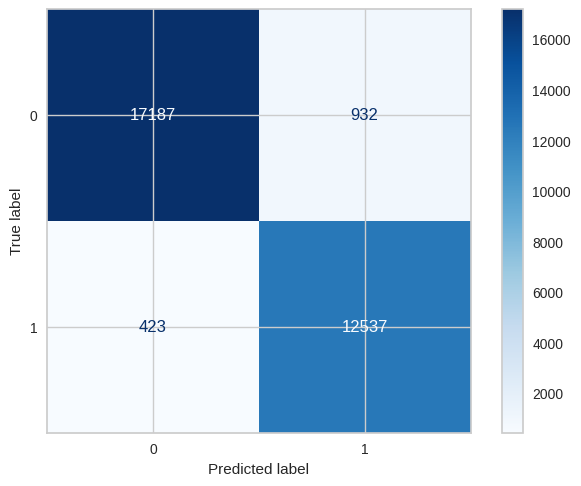

In [14]:
ConfusionMatrixDisplay(confusion_matrix(y_pred, y_test)).plot(cmap='Blues');

### **PyTorch**

I use PyTorch to create a neural network, experimenting with a randomly chosen architecture.

In [17]:
class SatisfactionDataset(data.Dataset):
  def __init__(self, X, y):
    super().__init__()
    self.X, self.y = X, y

  def __getitem__(self, index):
    return self.X[index], self.y[index]

  def __len__(self):
    return len(self.X)

In [18]:
class ClassificationSatisfaction(nn.Module):
  def __init__(self, n_input, n_output):
    super().__init__()

    self.layer1 = nn.Linear(n_input, 20)
    self.layer2 = nn.Linear(20, 20)
    self.layer3 = nn.Linear(20, n_output)

  def forward(self, x):
    x1 = torch.nn.functional.relu(self.layer1(x))
    x2 = torch.nn.functional.relu(self.layer2(x1))
    x3 = self.layer3(x2)

    return x3.float()

In [19]:
d_train = SatisfactionDataset(X_train, y_train)
train_data = data.DataLoader(d_train, batch_size=32, shuffle=True)

In [20]:
n_input, n_output = X_train.shape[1], 2
model = ClassificationSatisfaction(n_input, n_output)
model

ClassificationSatisfaction(
  (layer1): Linear(in_features=24, out_features=20, bias=True)
  (layer2): Linear(in_features=20, out_features=20, bias=True)
  (layer3): Linear(in_features=20, out_features=2, bias=True)
)

In [21]:
optimizer = optim.Adam(params=model.parameters(), lr=0.01)
loss_func = nn.CrossEntropyLoss()

In [22]:
history_train = []
history_val = []
accuracy_history = []
epochs = 10

model.train()
for e in range(epochs):
    train_losses = []

    train_tqdm = tqdm(train_data, leave=True)
    for x, y in train_tqdm:
        y_predict = model(x)
        loss = loss_func(y_predict, y.long())

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        train_losses.append(loss.item())

    avg_train_loss = sum(train_losses) / len(train_losses)
    history_train.append(avg_train_loss)
    model.eval()
    with torch.no_grad():
        val_outputs = model(X_test)
        val_loss = loss_func(val_outputs, y_test.long())
        history_val.append(val_loss.item())

        preds = val_outputs.argmax(dim=1).cpu()
        true_labels = y_test.cpu()
        accuracy = accuracy_score(true_labels, preds)
        accuracy_history.append(accuracy)

    model.train()

    print(f"Epoch {e+1}/{epochs} — Train Loss: {avg_train_loss:.4f}, Val Loss: {val_loss.item():.4f}, Val Accuracy: {accuracy:.3f}")

100%|██████████| 2267/2267 [00:04<00:00, 525.86it/s]


Epoch 1/10 — Train Loss: 0.1739, Val Loss: 0.1355, Val Accuracy: 0.941


100%|██████████| 2267/2267 [00:04<00:00, 489.07it/s]


Epoch 2/10 — Train Loss: 0.1278, Val Loss: 0.1233, Val Accuracy: 0.949


100%|██████████| 2267/2267 [00:04<00:00, 485.46it/s]


Epoch 3/10 — Train Loss: 0.1163, Val Loss: 0.1117, Val Accuracy: 0.953


100%|██████████| 2267/2267 [00:04<00:00, 543.58it/s]


Epoch 4/10 — Train Loss: 0.1141, Val Loss: 0.1082, Val Accuracy: 0.953


100%|██████████| 2267/2267 [00:04<00:00, 465.91it/s]


Epoch 5/10 — Train Loss: 0.1090, Val Loss: 0.1068, Val Accuracy: 0.955


100%|██████████| 2267/2267 [00:04<00:00, 510.42it/s]


Epoch 6/10 — Train Loss: 0.1070, Val Loss: 0.1087, Val Accuracy: 0.955


100%|██████████| 2267/2267 [00:04<00:00, 538.40it/s]


Epoch 7/10 — Train Loss: 0.1050, Val Loss: 0.1109, Val Accuracy: 0.954


100%|██████████| 2267/2267 [00:05<00:00, 445.30it/s]


Epoch 8/10 — Train Loss: 0.1034, Val Loss: 0.1051, Val Accuracy: 0.956


100%|██████████| 2267/2267 [00:04<00:00, 532.67it/s]


Epoch 9/10 — Train Loss: 0.1009, Val Loss: 0.1057, Val Accuracy: 0.955


100%|██████████| 2267/2267 [00:04<00:00, 547.38it/s]


Epoch 10/10 — Train Loss: 0.1025, Val Loss: 0.0991, Val Accuracy: 0.957


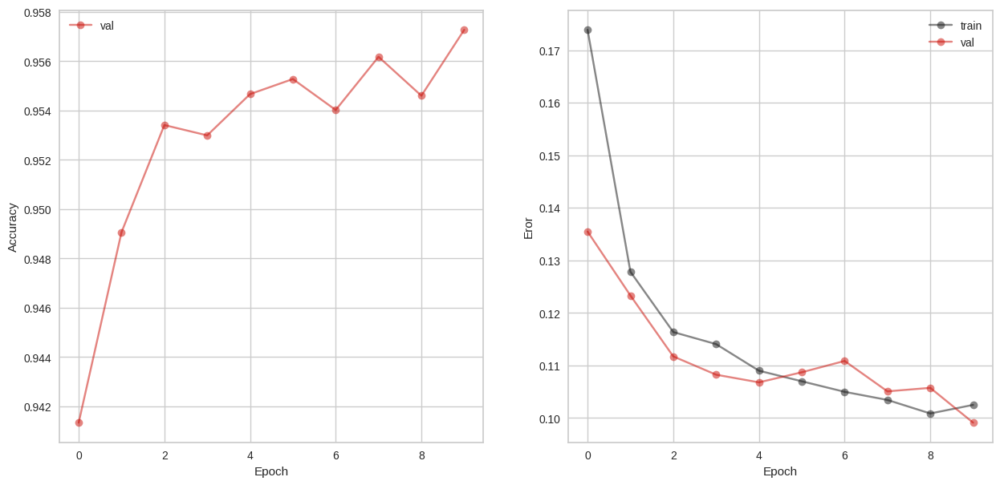

In [23]:
fig, axe = plt.subplots(1, 2, figsize=(15, 7))

axe[0].plot(accuracy_history, 'or-', alpha=.5, label='val')
axe[0].set_xlabel('Epoch')
axe[0].set_ylabel('Accuracy')
axe[0].legend()

axe[1].plot(history_train, 'ok-', alpha=.5, label='train')
axe[1].plot(history_val, 'or-', alpha=.5, label='val')
axe[1].legend()
axe[1].set_xlabel('Epoch')
axe[1].set_ylabel('Eror')
axe[1].legend();


### **TensorFlow**

Example of creating a simple neural network on TensorFlow

In [24]:
class ClassificationSatisfaction(keras.Model):
  def __init__(self, n_input, n_output):
    super().__init__()

    self.layer1 = layers.Dense(20, activation='relu', kernel_initializer='he_normal')
    self.layer2 = layers.Dense(20, activation='relu', kernel_initializer='he_normal')
    self.layer3 = layers.Dense(n_output)

  def call(self, x, training=False):
    x1 = self.layer1(x)
    x2 = self.layer2(x1)
    x3 = self.layer3(x2)

    return x3

In [25]:
n_input, n_output = X_train.shape[1], 2
model = ClassificationSatisfaction(n_input, n_output)
model.compile(optimizer='adam',
              loss=keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])

In [26]:
history = model.fit(X_train, y_train, epochs=10, validation_data=(X_test, y_test))
model.summary()

Epoch 1/10
2267/2267 ━━━━━━━━━━━━━━━━━━━━ 9s 3ms/step - accuracy: 0.8637 - loss: 0.3216 - val_accuracy: 0.9223 - val_loss: 0.1874
Epoch 2/10
2267/2267 ━━━━━━━━━━━━━━━━━━━━ 10s 3ms/step - accuracy: 0.9284 - loss: 0.1768 - val_accuracy: 0.9331 - val_loss: 0.1640
Epoch 3/10
2267/2267 ━━━━━━━━━━━━━━━━━━━━ 8s 4ms/step - accuracy: 0.9344 - loss: 0.1571 - val_accuracy: 0.9401 - val_loss: 0.1462
Epoch 4/10
2267/2267 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - accuracy: 0.9426 - loss: 0.1418 - val_accuracy: 0.9440 - val_loss: 0.1365
Epoch 5/10
2267/2267 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - accuracy: 0.9450 - loss: 0.1329 - val_accuracy: 0.9477 - val_loss: 0.1304
Epoch 6/10
2267/2267 ━━━━━━━━━━━━━━━━━━━━ 7s 3ms/step - accuracy: 0.9494 - loss: 0.1222 - val_accuracy: 0.9486 - val_loss: 0.1237
Epoch 7/10
2267/2267 ━━━━━━━━━━━━━━━━━━━━ 10s 3ms/step - accuracy: 0.9518 - loss: 0.1176 - val_accuracy: 0.9510 - val_loss: 0.1196
Epoch 8/10
2267/2267 ━━━━━━━━━━━━━━━━━━━━ 8s 4ms/step - accuracy: 0.9529 - loss: 0.1135 

Model: "classification_satisfaction"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense (Dense)                   │ (None, 20)             │           500 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 20)             │           420 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 2)              │            42 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,888 (11.29 KB)

 Trainable params: 962 (3.76 KB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 1,926 (7.53 KB)

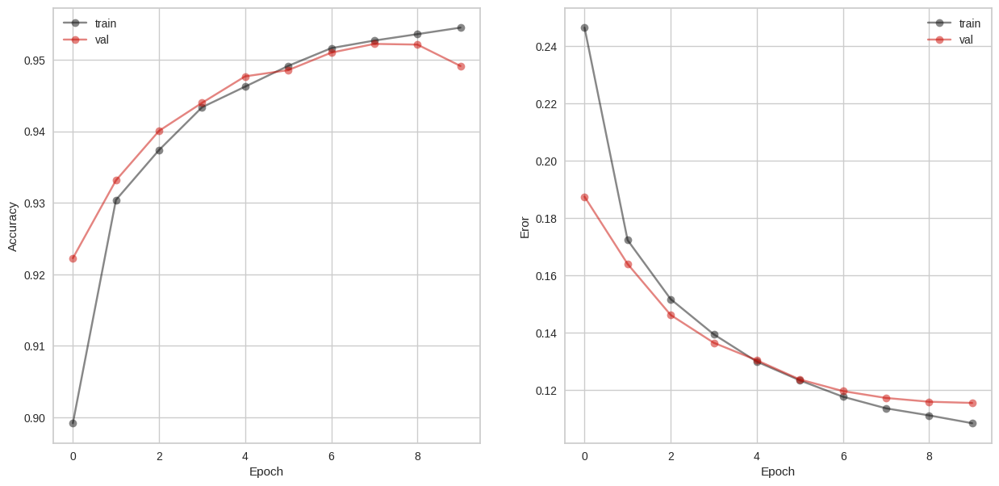

In [27]:
fig, axe = plt.subplots(1, 2, figsize=(15, 7))

axe[0].plot(history.history['accuracy'], 'ok-', alpha=.5, label='train')
axe[0].plot(history.history['val_accuracy'], 'or-', alpha=.5, label='val')
axe[0].set_xlabel('Epoch')
axe[0].set_ylabel('Accuracy')
axe[0].legend()

axe[1].plot(history.history['loss'], 'ok-', alpha=.5, label='train')
axe[1].plot(history.history['val_loss'], 'or-', alpha=.5, label='val')
axe[1].legend()
axe[1].set_xlabel('Epoch')
axe[1].set_ylabel('Eror')
axe[1].legend();